In [24]:
import os
import cv2
import mmcv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mmengine.config import Config
from mmengine.registry import init_default_scope
from mmdet.apis import inference_detector, init_detector
from mmrotate.visualization import RotLocalVisualizer

# Set the GPU to use
os.environ['CUDA_VISIBLE_DEVICES'] = '3'

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [25]:
# Configuration and checkpoint files
config_file = '../configs-mine/rhino/rhino_phc_haus-4scale_r50_2xb2-36e_m0.py'
checkpoint_file = '../work_dirs/rhino_phc_haus-4scale_r50_2xb2-36e_m0/epoch_50.pth'
test_image_dir = '../data/m0/val/images'
test_ann_dir = '../data/m0/val/annfiles'
out_dir = '../results/utils'

METAINFO = {
	'classes': ('CFCBK', 'FCBK', 'Zigzag'),
	'palette': [(255, 0, 0), (0, 255, 0), (0, 0, 255)]
}
objects_list = ["CFCBK", "FCBK", "Zigzag"]
objects_list = pd.Series(objects_list)
objects_list

0     CFCBK
1      FCBK
2    Zigzag
dtype: object

In [26]:
# Load the configuration file
cfg = Config.fromfile(config_file)
init_default_scope(cfg.get('default_scope', 'mmrotate'))

# Initialize the model
model = init_detector(cfg, checkpoint_file, device='cuda:0')

if not os.path.exists(out_dir):
    os.makedirs(out_dir)

# Initialize the visualizer
visualizer = RotLocalVisualizer()

Loads checkpoint by local backend from path: ../work_dirs/rhino_phc_haus-4scale_r50_2xb2-36e_m0/epoch_50.pth


In [27]:
image_files = os.listdir(test_image_dir)
image_files = sorted(image_files)[-10:]
num_images = len(image_files)
print(image_files)

['9026909_3082855.png', '9029661_3121380.png', '9032413_3124131.png', '9035164_3077352.png', '9035164_3088359.png', '9035164_3102117.png', '9037916_3088359.png', '9782413_2531591.png', '9785165_2520585.png', '9787916_2542598.png']


In [28]:
def draw_annotations(image, ann_file):
	"""Draws rotated bounding boxes from a DOTA annotation file using specified colors."""
	img = image.copy()
	if not os.path.exists(ann_file):
		print(f"Annotation file {ann_file} not found.")
		return img
	class_to_color = dict(zip(METAINFO['classes'], METAINFO['palette']))
	with open(ann_file, 'r') as f:
		lines = f.readlines()
	for line in lines:
		values = line.strip().split()
		if len(values) < 9:
			continue
		points = np.array(list(map(float, values[:8]))).reshape((4, 2)).astype(int)
		label = values[8]
		color = class_to_color.get(label, (255, 255, 255))
		thickness = 1
		cv2.polylines(img, [points], isClosed=True, color=color, thickness=thickness)
		cv2.putText(img, label, (points[0][0], points[0][1] - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
	return img


Processing image 1/10: 9026909_3082855.png


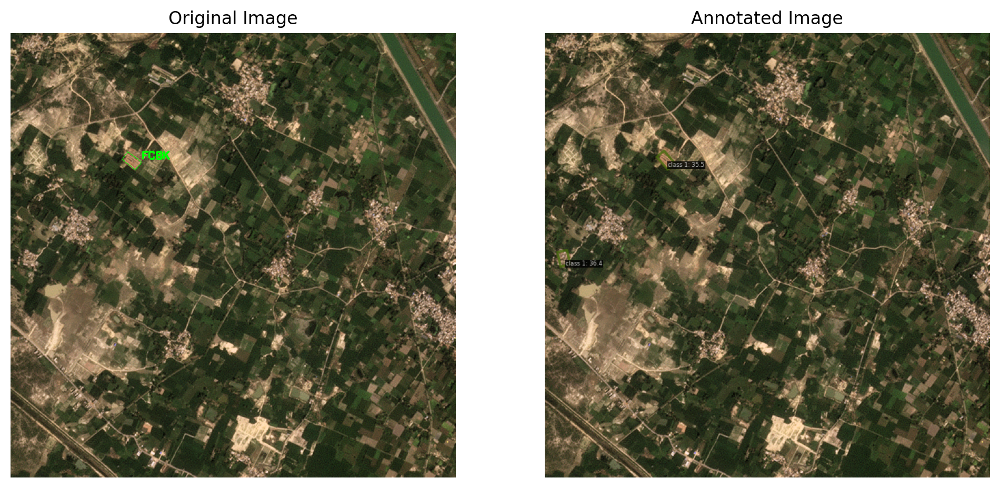

Processing image 2/10: 9029661_3121380.png


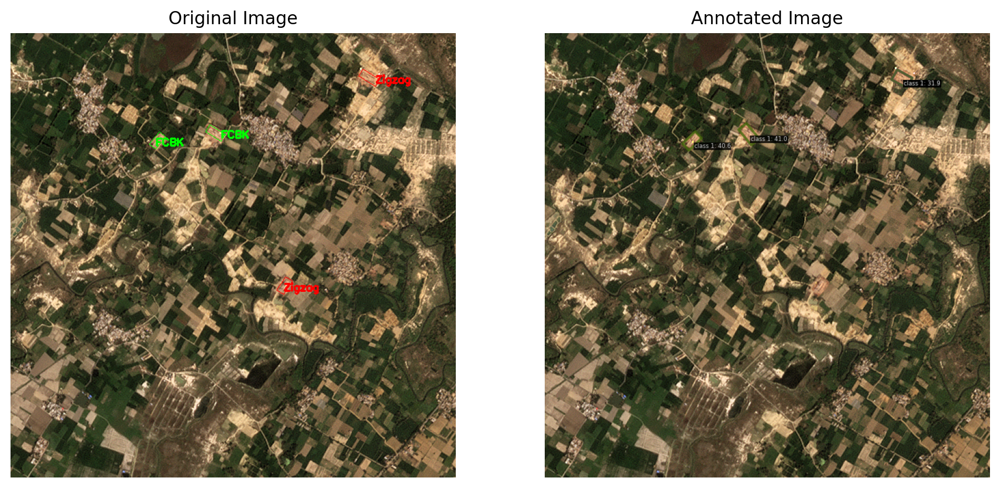

Processing image 3/10: 9032413_3124131.png


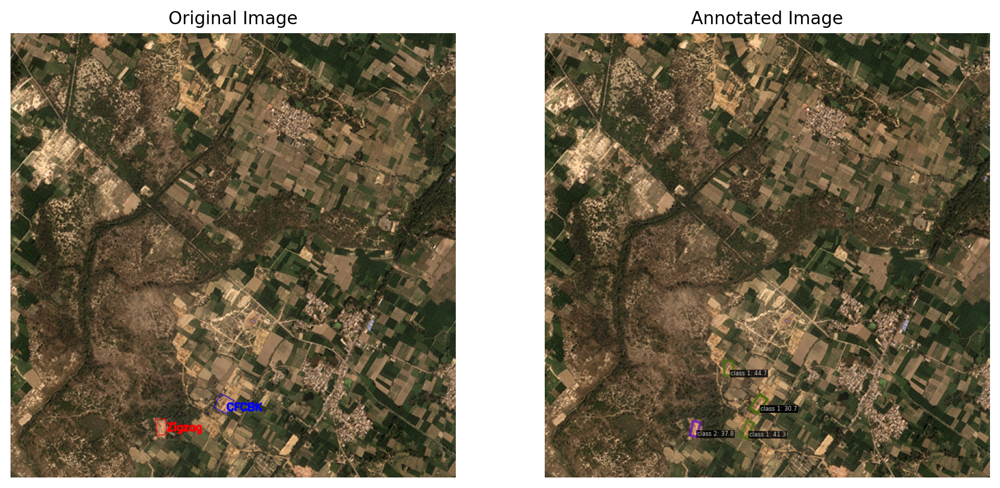

Processing image 4/10: 9035164_3077352.png


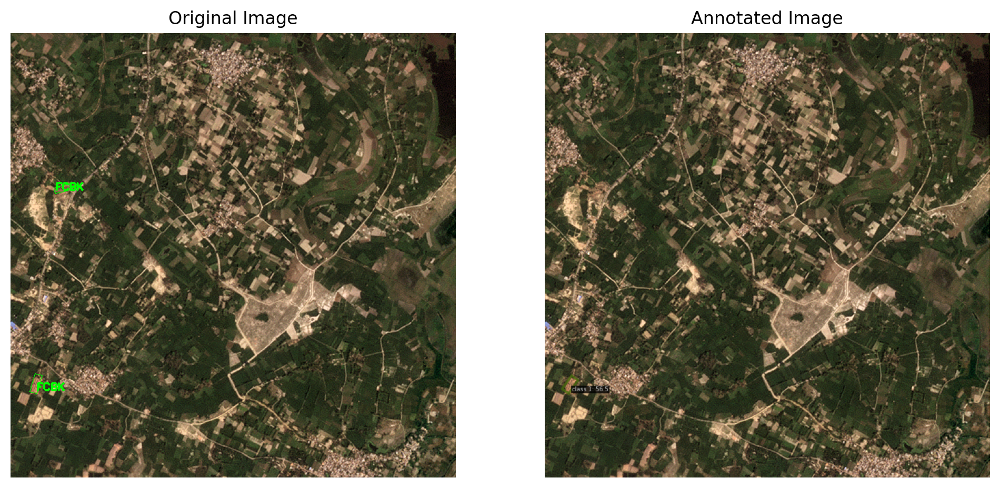

Processing image 5/10: 9035164_3088359.png


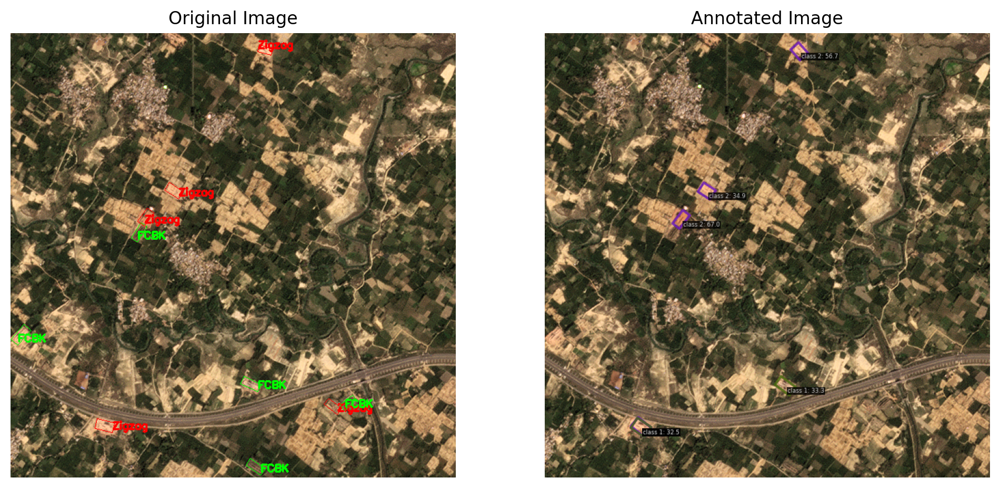

Processing image 6/10: 9035164_3102117.png


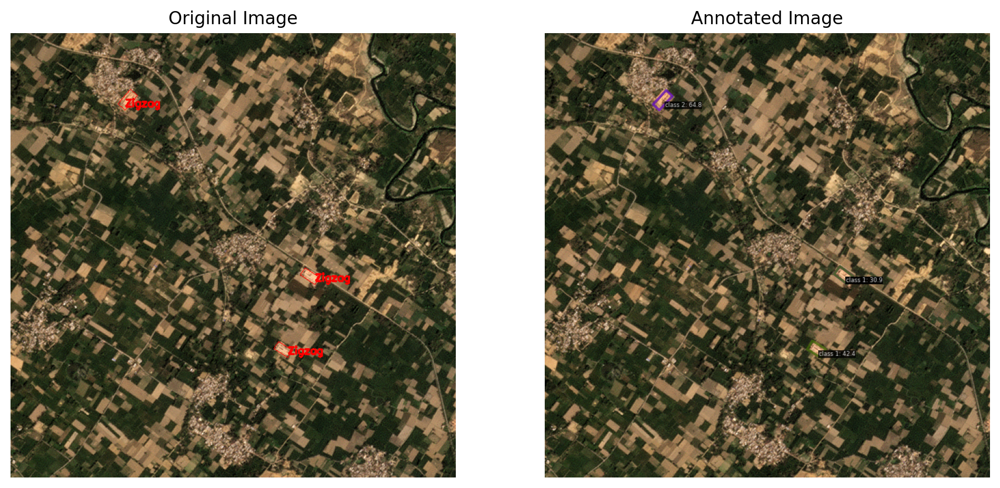

Processing image 7/10: 9037916_3088359.png


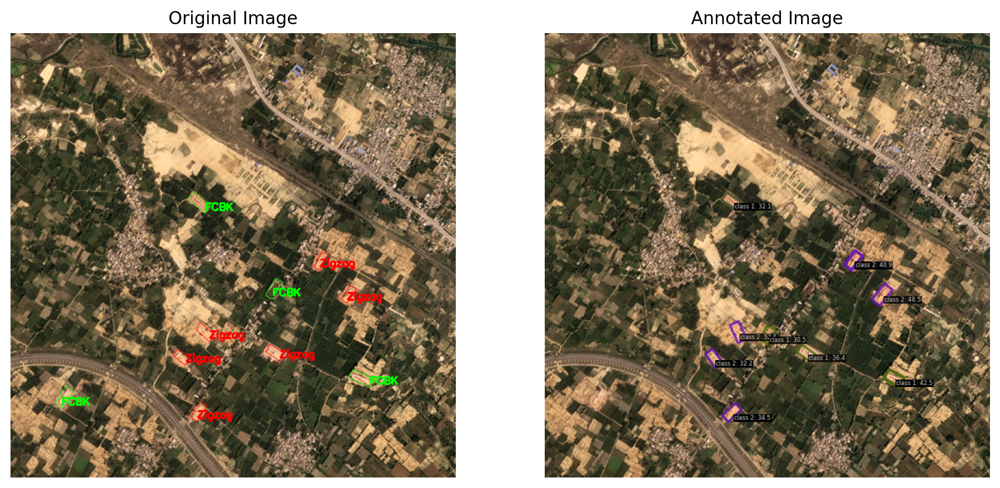

Processing image 8/10: 9782413_2531591.png


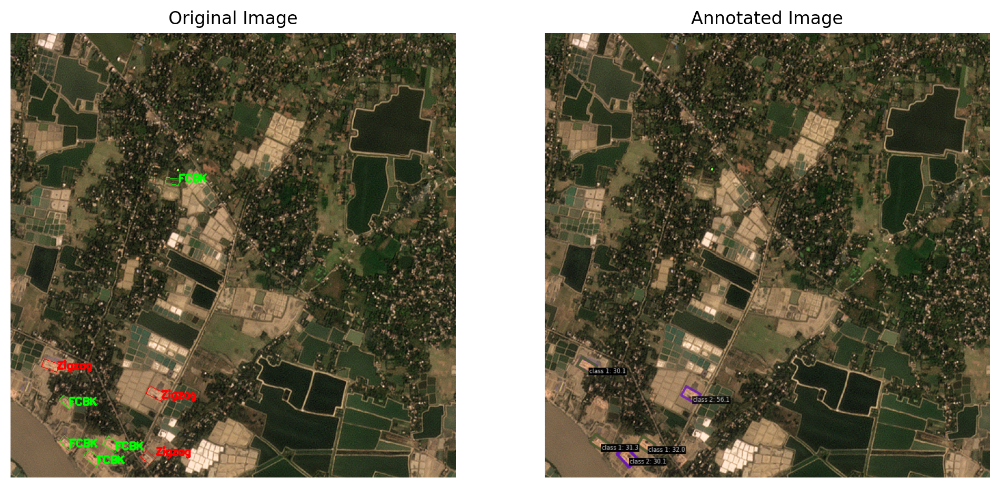

Processing image 9/10: 9785165_2520585.png


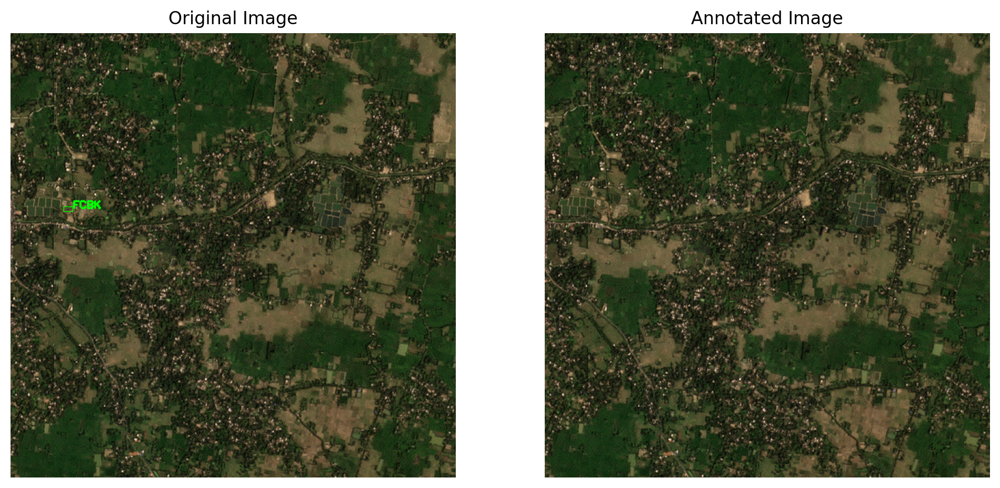

Processing image 10/10: 9787916_2542598.png


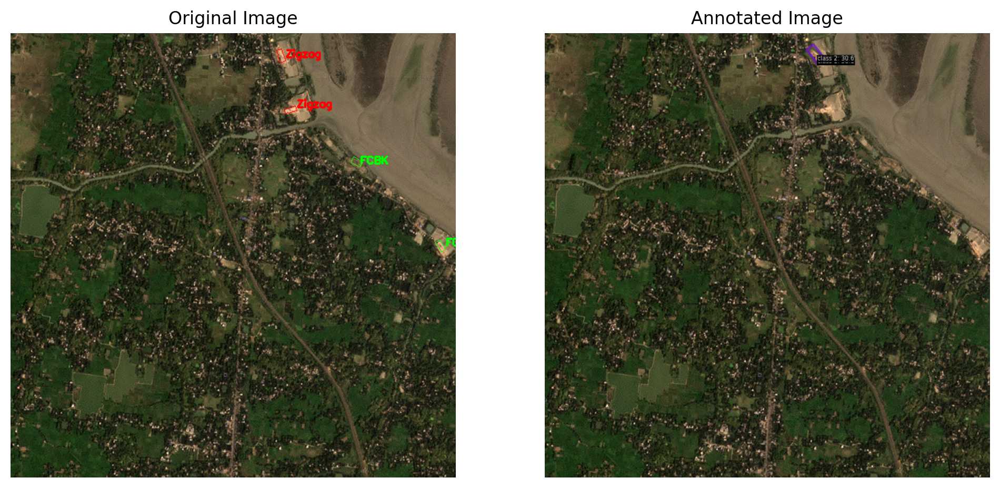

0

In [29]:
for i, image_name in enumerate(image_files):
    print(f"Processing image {i+1}/{num_images}: {image_name}")

    image_path = os.path.join(test_image_dir, image_name)
    ann_file = os.path.join(test_ann_dir, image_name.replace('.png', '.txt'))
    
    # Perform inference
    result = inference_detector(model, image_path)
    # print(result)  
    output_path = os.path.join(out_dir, image_name)
    visualizer.add_datasample(
        image_name,
        mmcv.imread(image_path),
        result,
        show=False,
        draw_gt = False,
        out_file=output_path
    )

    # Load both images
    img_original = mmcv.imread(image_path)
    img_original_annotated = draw_annotations(img_original, ann_file)
    inf_img_annotated = mmcv.imread(output_path)

    plt.figure(figsize=(12, 6))
    # Original Image with Annotations
    plt.subplot(1, 2, 1)
    plt.imshow(mmcv.bgr2rgb(img_original_annotated))
    plt.axis("off")
    plt.title("Original Image")
    # Annotated Image
    plt.subplot(1, 2, 2)
    plt.imshow(inf_img_annotated)
    plt.axis("off")
    plt.title("Annotated Image")
    plt.show()

# delete the out_dir
os.system(f'rm -rf {out_dir}')